<a href="https://colab.research.google.com/github/ahmadijo/Turbulence/blob/main/3D_DNS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Cupy (if necessary to utilize GPU)

In [ ]:
!curl https://colab.chainer.org/install | sh -

!pip install cucim
!pip install scipy scikit-image cupy-cuda100

## Libraries and save/load variables

In [1]:
import numpy as np
import cupy as cp
import cucim

import matplotlib.pyplot as plt

import time as tt

In [5]:
with open('inds.npy', 'wb') as f:
    np.save(f, inds)

In [ ]:
with open('E_ii.npy', 'rb') as f:
    Eii = np.load(f)

with open('inds.npy', 'rb') as f:
    inds = np.load(f)

# Read data

The first cell reads the information from an snapshot and reconstruct the velocity field ($u$,$v$,$w$) based on inverse Fourier transform.

In [1]:
import h5py as h5
from pylab import * 

N=1024 #Size of the box in points

Ny=N
Nx=N
Nz=N/2+1

filename='/content/drive/MyDrive/Colab Notebooks/hit.1024.00013.h5' #File to read
f = h5.File(filename, 'r')

up = f['u'][:] #Read k_x=0 plane of u
v =  f['v'][:] #Read v
w =  f['w'][:] #Read w

up.dtype='c8'
v.dtype ='c8'
w.dtype ='c8'
u=zeros((N,N,N//2+1),dtype='c8')

#Fill the k_x=0 plane of u
u[0,:,:] = up;

#Generate wave-number vectors kx,ky and kz
k=r_[0:N//2,-N//2:0]
kx=k.reshape((-1, 1, 1))
ky=k.reshape(( 1,-1, 1))
kz=k[0:(N//2+1)].reshape(( 1, 1,-1))

#Reconstruct u
# Method 1 is faster but needs larger memory, since method 2 is used to
# reconstruct the u. The following priciple is used for this purpose
# kx*u + ky*v + kz*w = 0 due to continuity
# Method 1
#u[1:,...]=((-ky*v-kz*w)/kx)[1:,...]
# Method 2
for i in range(u.shape[0]-1):
  i +=1
  u[i,:,:] = (-ky.reshape(-1,1)*v[i,:,:] 
              - kz.reshape(1,-1)*w[i,:,:])/kx[i,0,0]


# Inverse discrete Fourier transform using CPU/GPU

In [ ]:
#Transfor velocities to real space
# This step requires a huge portion of memory and can be skipped
#u=irfftn(u)
#v=irfftn(v)
#w=irfftn(w)

In [ ]:
#u = cp.fft.irfftn(cp.asarray(u))
#v = cp.fft.irfftn(cp.asarray(v))
#w = cp.fft.irfftn(cp.asarray(w))

$u$, $v$, and $w$ are arrays of ($1024^3$) size which can be used in the rest of this script for further post processings. For instance, the $u$-velocity is animated here at different $z$ planes:

In [ ]:
import matplotlib.animation as animation

from matplotlib import rc
rc('animation', html='jshtml')

fig, ax = plt.subplots()
close(fig)

ims = []
for i in range(225):
    im = ax.imshow(cp.asnumpy(v[:,:,i]), animated=True)
#    if i == 0:
#ax.imshow(cp.asnumpy(u[:,:,i*2]))  # show an initial one first
    ims.append([im])

anim = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

plt.show()
anim

#Uncomment if you would like to save the animation
#writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Farzad'), bitrate=1800)
#anim.save("Zspan.mp4", writer=writer)

# Performing spectral analysis

This section requires significant memory. Instead, you can just load 'Eii' variable from E_ii.npy file

In [3]:
dim=1024

#Domian, i.e., x1, x2, x3 are in the range of [0,L]
L=2*np.pi

#Eii = (np.abs(u)/dim**3)**2 + (np.abs(v)/dim**3)**2 + (np.abs(w)/dim**3)**2;

# The above code reads half of the fft coefficients. You can uncomment the code below
# to restore the full array of coefficient.
#Eii = np.concatenate((Eii,np.flip(Eii, axis=2)[:,:,1:-1]), axis=2)

k_end=int(dim/2)
dx=2*np.pi/L
k=(np.array(range(k_end))+1)*dx

The operations in this section are for caclulation of integration in 3D $k$-space. You can just load the 'inds' variable from the inds.py file.

In [4]:
rx=np.array(range(dim))-dim/2+1
rx=np.roll(rx,int(dim/2)+1)

rx =  rx**2
r = np.zeros((dim,dim,dim))

for i in range(dim):
  r[i,:,:] = np.sqrt(np.ones((dim,dim))*rx.reshape(-1,1) 
                + np.ones((dim,dim))*rx.reshape(1,-1) 
                + np.ones((dim,dim))*rx[i])

bins=np.zeros((k.shape[0]+1))
for N in range(k_end):
    if N==0:
        bins[N]=0
    else:
        bins[N]=(k[N]+k[N-1])/2    
bins[-1]=k[-1]
inds = np.zeros((dim,dim,dim))
for i in range(r.shape[0]):
  inds[i,:,:] = np.digitize(r[i,:,:]*dx, bins)

In [6]:
spectrum=np.zeros((k.shape[0]))
bin_counter=np.zeros((k.shape[0]))

for N in range(k_end):
    spectrum[N]=np.sum(Eii[inds==N+1])
    bin_counter[N]=np.count_nonzero(inds==N+1)

spectrum=spectrum*2*np.pi*(k**2)/(bin_counter*dx**3)

# -5/3 Power Law

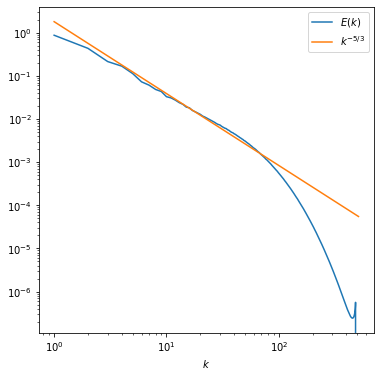

In [26]:
fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111)
ax.plot(k,spectrum, label = '$E(k)$')
ax.plot(k,1.8*k**(-5/3), label = '$k^{-5/3}$')
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('$k$')

ax.legend(loc = 'best')